# Music instrument recognition using deep convolutional neural networks

In [1]:
import json
import math
import time

import tensorflow.keras as keras

import librosa
import librosa.display

import numpy as np

import os

from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt

import re

import pickle
from tensorflow.keras.callbacks import EarlyStopping, LearningRateScheduler, ModelCheckpoint
from tensorflow.keras.models import load_model

### Visualizing Audio Signal

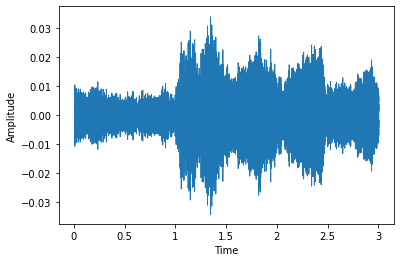

In [12]:
file = 'AudioFiles/TrainingData/cel/008__[cel][nod][cla]0058__1.wav'

# Waveform
signal, sr = librosa.load(file, sr = 22050)
librosa.display.waveshow(signal, sr = sr)
plt.xlabel("Time")
plt.ylabel("Amplitude")
plt.show()

### Analyzing Frequency - Power-spectrum

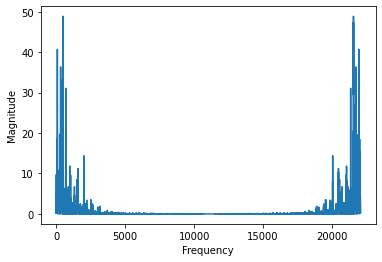

In [13]:
fft = np.fft.fft(signal)
magnitude = np.abs(fft)
frequency = np.linspace(0, sr, len(magnitude))

plt.plot(frequency, magnitude)

plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.show()

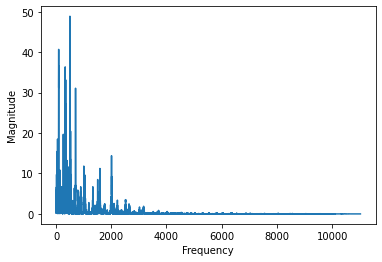

In [14]:
left_frequency = frequency[:int(len(frequency) / 2)]
left_magnitude = magnitude[:int(len(magnitude) / 2)]

plt.plot(left_frequency, left_magnitude)

plt.xlabel("Frequency")
plt.ylabel("Magnitude")
plt.show()

### STFT -> Spectrogram

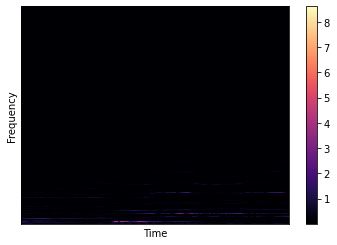

In [15]:
n_fft = 2048
hop_length = 512

stft = librosa.core.stft(signal, hop_length = hop_length, n_fft = n_fft)
spectrogram = np.abs(stft)

librosa.display.specshow(spectrogram, sr = sr, hop_length = hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.show()

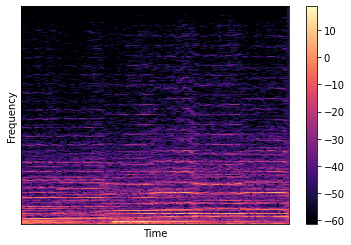

In [16]:
log_spectrogram = librosa.amplitude_to_db(spectrogram)

librosa.display.specshow(log_spectrogram, sr = sr, hop_length = hop_length)
plt.xlabel("Time")
plt.ylabel("Frequency")
plt.colorbar()
plt.show()

### Plotting MFCCs

C:\Users\aitha\AppData\Local\Temp\ipykernel_16572\3844570871.py:1: FutureWarning: Pass y=[-0.00053028 -0.0002775   0.00054321 ... -0.00324738 -0.00398339
  0.        ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  MFFCs = librosa.feature.mfcc(signal, n_fft = n_fft, hop_length = hop_length, n_mfcc = 13)


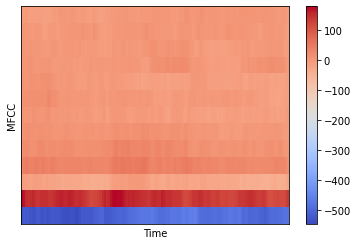

In [17]:
MFFCs = librosa.feature.mfcc(signal, n_fft = n_fft, hop_length = hop_length, n_mfcc = 13)

librosa.display.specshow(MFFCs, sr = sr, hop_length = hop_length)

plt.xlabel("Time")
plt.ylabel("MFCC")
plt.colorbar()
plt.show()

### Creating Dataset

In [2]:
DATASET_PATH = "AudioFiles/TrainingData"
JSON_PATH = "data.json"
SAMPLE_RATE = 22050
DURATION = 2
SAMPLE_PER_TRACK = SAMPLE_RATE * DURATION

In [25]:
def save_mfcc(dataset_path, json_path, n_mfcc = 13, n_fft = 2048, hop_length = 512, n_segments = 5):

    # Building dictionary to store data
    data = {
        "mapping" : [],
        "mfcc" : [],
        "labels" : []
    }

    n_samples_per_segment = int(SAMPLE_PER_TRACK / n_segments)
    expected_n_mfcc_vectors_per_segment = math.ceil(n_samples_per_segment / hop_length)

    # Loop through all the instruments
    for i, (dirpath, dirnames, filenames) in enumerate(os.walk(dataset_path)):

        # Ensure that we are not at the root level
        if dirpath is not dataset_path:

            # Save the semantic label
            dirpath_components = dirpath.split("\\")
            semantic_label = dirpath_components[-1]

            data["mapping"].append(semantic_label)

            print("\nProcessing {}".format(semantic_label))

            # Process files for a specific instrument
            for f in filenames:

                # Loading the audio file
                file_path = os.path.join(dirpath, f)
                signal, sr = librosa.load(file_path, sr = SAMPLE_RATE)

                # Process segments extracting mfcc and storing data
                for s in range(n_segments):
                    start_sample = n_samples_per_segment * s
                    finish_sample = start_sample + n_samples_per_segment

                    mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)

                    # mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, htk = True, hop_length = hop_length)

                    mfcc = mfcc.T

                # Store mfcc for segment if it has the expected length
                    if len(mfcc) == expected_n_mfcc_vectors_per_segment:
                        data["mfcc"].append(mfcc.tolist())
                        data["labels"].append(i - 1)

    with open(JSON_PATH, "w") as fp:
        json.dump(data, fp, indent = 4)

if __name__ == "__main__":
    save_mfcc(DATASET_PATH, JSON_PATH, n_segments = 10, n_mfcc = 64, hop_length = 512)


Processing cel


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-5.3027587e-04 -2.7750156e-04  5.4320996e-04 ... -9.0118119e-05
  7.7151439e-05  7.1292470e-04] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[0.00166339 0.0024941  0.00269966 ... 0.0005855  0.00043437 0.00061554] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00078251  0.00084484  0.00099678 ... -0.00256673 -0.00138504
 -0.00026146] as keyword args. Fro


Processing cla


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.03562681 -0.05393364 -0.04869252 ... -0.01138664 -0.01034145
 -0.0089634 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.00785468 -0.00731859 -0.00673239 ... -0.04664055 -0.04608926
 -0.04138241] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.03382223 -0.02447555 -0.0139018  ...  0.0292213   0.02888261
  0.02821941] as keyword args. From version 0


Processing flu


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.05530004  0.07605296  0.05481591 ...  0.01594384 -0.0012476
 -0.01813705] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.03920627 -0.05757313 -0.06924969 ...  0.08085725  0.07256178
  0.06391682] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.04747877  0.02446694  0.00515451 ... -0.05374638 -0.0461055
 -0.03586543] as keyword args. From version 0.1


Processing gac


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.0844247  -0.08288168 -0.07974584 ...  0.00497244 -0.02660408
 -0.03472815] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.05306184  0.07274467  0.0490598  ... -0.00050408  0.0125864
  0.02967755] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.02895695  0.01216977 -0.00691576 ...  0.05844294  0.05381465
  0.04979585] as keyword args. From version 0.


Processing gel


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.44073418 -0.33397546 -0.20008121 ...  0.15188749 -0.01352609
 -0.16443735] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.28005177 -0.24611321 -0.13592425 ...  0.28277004  0.23676112
  0.1326395 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.11234177  0.04272918  0.06355096 ... -0.01986145 -0.05139076
 -0.12375581] as keyword args. From version 0


Processing mridangam


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[0.02229563 0.02265253 0.02344291 ... 0.00414697 0.00385362 0.00359512] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00338379  0.00323764  0.00301024 ... -0.01157808 -0.01084985
 -0.01135245] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00683582  0.00906644  0.00690856 ... -0.00397373 -0.00394561
 -0.00387278] as keyword args. From version 0.10 pas


Processing org


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.01742559 -0.018135    0.00026375 ...  0.23186503  0.23748296
  0.25315955] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.2506132   0.24947755  0.2512561  ... -0.10480479 -0.06532589
 -0.07109066] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.0695333  -0.05469255 -0.08207151 ...  0.02309348  0.02243439
  0.01493466] as keyword args. From version 0


Processing pia


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.02567824  0.03764099  0.03252696 ... -0.01744337 -0.01665737
 -0.01616786] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.01618141 -0.01662364 -0.0173271  ...  0.04595465  0.04922611
  0.05217316] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.05413055  0.05514162  0.05542558 ...  0.00588578 -0.00658387
 -0.02092172] as keyword args. From version 0


Processing sax


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.06134349 -0.09625768 -0.09222922 ... -0.10017891 -0.11253685
 -0.11943508] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.1223791  -0.12345631 -0.12368423 ... -0.12014186 -0.13337596
 -0.14456433] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.14952348 -0.14608191 -0.13548857 ...  0.03533747  0.02944793
  0.02188945] as keyword args. From version 0


Processing sitar


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.00351362 -0.00471823 -0.0043211  ... -0.00414193 -0.00266042
  0.00054591] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00310419  0.00386113  0.00441244 ...  0.00049251 -0.0005537
 -0.0010133 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00126366  0.00307339  0.00020447 ... -0.00366287 -0.00190231
 -0.00029982] as keyword args. From version 0.


Processing tabla


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[0.20930552 0.30506834 0.26313096 ... 0.02001821 0.01399687 0.01161436] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.00801476  0.00399229  0.00210915 ... -0.00839124 -0.0091028
 -0.0078099 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.00862338 -0.00694156 -0.00623601 ... -0.01212198 -0.01129722
 -0.01000331] as keyword args. From version 0.10 pass


Processing tru


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[0.03445964 0.06286221 0.04602648 ... 0.07232288 0.0846888  0.06201151] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.06254361  0.06583682  0.05553599 ... -0.11547942 -0.08466884
 -0.10917792] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.10017618 -0.10047699 -0.13189141 ...  0.05605035  0.07606009
  0.07885866] as keyword args. From version 0.10 pas


Processing veena


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[0.06264321 0.09062102 0.11614361 ... 0.32240185 0.25635716 0.13152704] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.01704382 -0.12394129 -0.08157902 ...  0.28642702  0.30697945
  0.3113792 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.3097171   0.30480167  0.26830778 ...  0.05348426  0.04015785
 -0.01688781] as keyword args. From version 0.10 pas


Processing vio


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.04214048  0.05742223  0.04100956 ... -0.09132444 -0.04520898
 -0.00918687] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.00229918 -0.02216693 -0.05619787 ... -0.1817329  -0.19431135
 -0.17848161] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[-0.15619887 -0.1387616  -0.13849476 ... -0.11731711 -0.10374447
 -0.10059191] as keyword args. From version 0


Processing voi


C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.04338605  0.07910448 -0.05936943 ...  0.03562675  0.07779629
  0.11037623] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.14450923  0.16938692  0.17139815 ... -0.04869841  0.00443272
  0.05714105] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mfcc = librosa.feature.mfcc(signal[start_sample : finish_sample], sr = sr, n_fft = n_fft, n_mfcc = n_mfcc, hop_length = hop_length)
C:\Users\aitha\AppData\Local\Temp\ipykernel_14452\2770353305.py:39: FutureWarning: Pass y=[ 0.07983915  0.05197578  0.00544257 ...  0.10502817  0.00957451
 -0.1189255 ] as keyword args. From version 0

# Instrument classification


In [3]:
# Load data
def load_data(dateset_path):
    with open(dateset_path, "r") as fp:
        data = json.load(fp)

    # Convert lists into numpy arrays
    inputs = np.array(data["mfcc"])
    targets = np.array(data["labels"])

    return inputs, targets

### Defining model history plotting function

In [27]:
# Plotting accuracy and error over the epochs

def plot_history(history):
    fig, axs = plt.subplots(2)

    # Creating accuracy sub-plot
    axs[0].plot(history.history["accuracy"], label = "train accuracy")
    axs[0].plot(history.history["val_accuracy"], label = "test accuracy")
    axs[0].set_ylabel("Accuracy")
    axs[0].legend(loc = "lower right")
    axs[0].set_title("Accuracy eval")

    # Creating error sub-plot
    axs[1].plot(history.history["loss"], label = "train error")
    axs[1].plot(history.history["val_loss"], label = "test error")
    axs[1].set_xlabel("Epoch")
    axs[1].set_ylabel("Error")
    axs[1].legend(loc = "upper right")
    axs[1].set_title("Error eval")

    plt.show()

### Defining predicting function

In [8]:
def predict(model, X, y):
    X = X[np.newaxis, ...]

    # prediction = [[11 probabilities]]
    prediction = model.predict(X)

    print("Predicted probabilities : ", prediction)

    # Extract index with max value
    predicted_index = np.argmax(prediction, axis = 1)
    print("Expected index : {}, Predicted index : {}".format(y, predicted_index))


### Defining model training resume capability functions

In [29]:
def hms_string(sec_elapsed):
    h = int(sec_elapsed / (60 * 60))
    m = int((sec_elapsed % (60 * 60)) / 60)
    s = sec_elapsed % 60
    return f"{h}:{m:>02}:{s:>05.2f}"

In [30]:
def generate_output_dir(outdir, run_desc):
    prev_run_dirs = []
    if os.path.isdir(outdir):
        prev_run_dirs = [x for x in os.listdir(outdir) if os.path.isdir(
            os.path.join(outdir, x))]
    prev_run_ids = [re.match(r'^\d+', x) for x in prev_run_dirs]
    prev_run_ids = [int(x.group()) for x in prev_run_ids if x is not None]
    cur_run_id = max(prev_run_ids, default=-1) + 1
    run_dir = os.path.join(outdir, f'{cur_run_id:05d}-{run_desc}')
    assert not os.path.exists(run_dir)
    os.makedirs(run_dir)
    return run_dir


In [31]:
OUTPUT_DIRECTORY = './resumeData/'
RUN_DESC = "test-train"
BATCH_SIZE = 32
NUM_CLASSES = 15

In [32]:
class MyModelCheckpoint(ModelCheckpoint):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)

    def on_epoch_end(self, epoch, logs=None):
        super().on_epoch_end(epoch,logs)

        # Also save the optimizer state
        filepath = self._get_file_path(epoch=epoch,
                                       logs=logs, batch = None)
        filepath = filepath.rsplit( ".", 1 )[ 0 ]
        filepath += ".pkl"

        with open(filepath, 'wb') as fp:
            pickle.dump(
                {
                    'opt': model.optimizer.get_config(),
                    'epoch': epoch+1
                    # Add additional keys if you need to store more values
                }, fp, protocol=pickle.HIGHEST_PROTOCOL)
        print('\nEpoch %05d: saving optimizer to %s' % (epoch + 1, filepath))

In [33]:
def step_decay_schedule(initial_lr=1e-3, decay_factor=0.75, step_size=10):
    def schedule(epoch):
        return initial_lr * (decay_factor ** np.floor(epoch/step_size))
    return LearningRateScheduler(schedule)

In [10]:
def load_model_data(model_path, opt_path):
    model = load_model(model_path)
    with open(opt_path, 'rb') as fp:
        d = pickle.load(fp)
        epoch = d['epoch']
        opt = d['opt']
        return epoch, model, opt

In [35]:
def train_model(model, initial_epoch = 0, max_epochs = 10, X_train = None, y_train = None, X_test = None, y_test = None, validation_data = None):
    start_time = time.time()

    checkpoint_cb = MyModelCheckpoint(
        os.path.join(run_dir, 'model-{epoch:02d}-{val_loss:.2f}.hdf5'),
        monitor='val_loss',verbose=1)

    lr_sched_cb = step_decay_schedule(initial_lr = 1e-4, decay_factor = 0.75,
                                      step_size = 2)
    cb = [checkpoint_cb, lr_sched_cb]

    history = model.fit(X_train, y_train,
              batch_size = 32,
              epochs = max_epochs,
              initial_epoch = initial_epoch,
              verbose = 2,
              validation_data = validation_data,
              callbacks = cb
              )

    if X_test is not None:
        score = model.evaluate(X_test, y_test, verbose = 0, callbacks = cb)
        print('Test loss: {}'.format(score[0]))
        print('Test accuracy: {}'.format(score[1]))

    elapsed_time = time.time() - start_time
    print("Elapsed time: {}".format(hms_string(elapsed_time)))

    return history

## Neural network 1

In [14]:
run_dir = generate_output_dir(outdir = OUTPUT_DIRECTORY, run_desc = RUN_DESC)
print("Results saved to : {}".format(RUN_DESC))
print(run_dir)

Results saved to : test-train
./resumeData/00013-test-train


In [15]:
if  __name__ == "__main__":
    inputs, targets = load_data(JSON_PATH)

    # Split the data into training and test set
    inputs_train, inputs_test, targets_train, targets_test = train_test_split(inputs, targets, test_size = 0.3)

    # Building the network architecture
    model = keras.Sequential(
        [
            # Input layer
            keras.layers.Flatten(input_shape = (inputs.shape[1], inputs.shape[2])),

            # 1st Hidden layer
            keras.layers.Dense(512, activation = "relu"),

            # 2nd Hidden layer
            keras.layers.Dense(256, activation = "relu"),

            # 3rd Hidden layer
            keras.layers.Dense(64, activation = "relu"),

            # Output layer
            keras.layers.Dense(15, activation = "softmax")
        ]
    )

    # Compile the network
    optimizer = keras.optimizers.Adam(learning_rate = 0.0001)

    model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])

    model.summary()

    # Train network
    basicModelHistory = train_model(model = model, initial_epoch = 0, max_epochs = 50, X_train = inputs_train, y_train = targets_train, validation_data = (inputs_test, targets_test))

    # basicModelHistory = basicModel.fit(inputs_train, targets_train, validation_data = (inputs_test, targets_test), epochs = 100, batch_size = 32)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 100)               0         
                                                                 
 dense (Dense)               (None, 512)               51712     
                                                                 
 dense_1 (Dense)             (None, 256)               131328    
                                                                 
 dense_2 (Dense)             (None, 64)                16448     
                                                                 
 dense_3 (Dense)             (None, 15)                975       
                                                                 
Total params: 200,463
Trainable params: 200,463
Non-trainable params: 0
_________________________________________________________________
Epoch 1/50

Epoch 1: saving model to ./resumeData/

### Solving over-fitting issue to fix testing accuracy

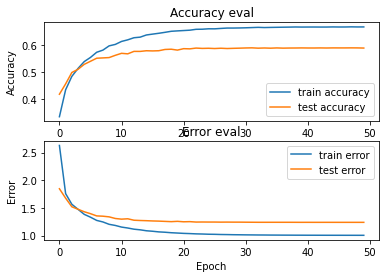

In [16]:
plot_history(basicModelHistory)

In [17]:
run_dir = generate_output_dir(outdir = OUTPUT_DIRECTORY, run_desc = RUN_DESC)
print("Results saved to : {}".format(RUN_DESC))
print(run_dir)

Results saved to : test-train
./resumeData/00014-test-train


Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_2 (Flatten)         (None, 100)               0         
                                                                 
 dense_8 (Dense)             (None, 512)               51712     
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_9 (Dense)             (None, 256)               131328    
                                                                 
 dropout_4 (Dropout)         (None, 256)               0         
                                                                 
 dense_10 (Dense)            (None, 64)                16448     
                                                                 
 dropout_5 (Dropout)         (None, 64)               

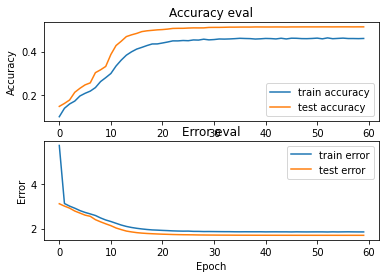

In [19]:
if  __name__ == "__main__":
    inputs, targets = load_data(JSON_PATH)

    # Building the network architecture
    model = keras.Sequential(
        [
            # Input layer
            keras.layers.Flatten(input_shape = (inputs.shape[1], inputs.shape[2])),

            # 1st Hidden layer
            keras.layers.Dense(512, activation = "relu", kernel_regularizer = keras.regularizers.l2(0.001)),
            keras.layers.Dropout(0.3),

            # 2nd Hidden layer
            keras.layers.Dense(256, activation = "relu", kernel_regularizer = keras.regularizers.l2(0.001)),
            keras.layers.Dropout(0.3),

            # 3rd Hidden layer
            keras.layers.Dense(64, activation = "relu", kernel_regularizer = keras.regularizers.l2(0.001)),
            keras.layers.Dropout(0.3),

            # Output layer
            keras.layers.Dense(15, activation = "softmax")
        ]
    )

    # Compile the network
    optimizer = keras.optimizers.Adam(learning_rate = 0.0001)

    model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics = ["accuracy"])

    model.summary()

    # Train network
    basicModelFixHistory = train_model(model = model, initial_epoch = 0, max_epochs = 60, X_train = inputs_train, y_train = targets_train, validation_data = (inputs_test, targets_test))

    # basicModelFixHistory = model.fit(inputs_train, targets_train, validation_data = (inputs_test, targets_test), epochs = 100, batch_size = 32)

plot_history(basicModelFixHistory)


## Neural network 2 - CNN


In [36]:
run_dir = generate_output_dir(outdir = OUTPUT_DIRECTORY, run_desc = RUN_DESC)
print("Results saved to : {}".format(RUN_DESC))
print(run_dir)

Results saved to : test-train
./resumeData/00013-test-train


In [6]:
def prepare_cnn_datasets(test_size, validation_size):
    # Load the data
    X, y = load_data(JSON_PATH)

    # Create train/test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = test_size, random_state = 44)

    # Create train/validation split
    X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size = validation_size, random_state = 44)

    # Tensorflow CNN expect 3D array -> (time_bins, number of mfccs, channels = 1)

    X_train = X_train[..., np.newaxis]  # 4d array -> (number of samples, time_bins, number of mfccs, channels = 1)

    X_validation = X_validation[..., np.newaxis]

    X_test = X_test[..., np.newaxis]

    return X_train, X_validation, X_test, y_train, y_validation, y_test

In [7]:
X_train, X_validation, X_test, y_train, y_validation, y_test = prepare_cnn_datasets(0.2, 0.2)

input_shape = (X_train.shape[1], X_train.shape[2], X_train.shape[3])

In [39]:
def build_cnn_model(input_shape):
    # Create model
    model = keras.Sequential()

    # 1st Conv Layer
    model.add(keras.layers.Conv2D(32, (3, 3), activation = 'relu', input_shape = input_shape, padding = 'same'))
    model.add(keras.layers.MaxPool2D((3, 3), strides = (2, 2), padding = 'same'))
    model.add(keras.layers.BatchNormalization())

    # 2nd Conv Layer
    model.add(keras.layers.Conv2D(64, (3, 3), activation = 'relu', input_shape = input_shape, padding = 'same'))
    model.add(keras.layers.MaxPool2D((3, 3), strides = (2, 2), padding = 'same'))
    model.add(keras.layers.BatchNormalization())

    # 3rd Conv Layer
    model.add(keras.layers.Conv2D(128, (3, 3), activation = 'relu', input_shape = input_shape, padding = 'same'))
    model.add(keras.layers.MaxPool2D((3, 3), strides = (2, 2), padding = 'same'))
    model.add(keras.layers.BatchNormalization())

    # 4th Conv Layer
    model.add(keras.layers.Conv2D(512, (3, 3), activation = 'relu', input_shape = input_shape, padding = 'same'))
    model.add(keras.layers.MaxPool2D((3, 3), strides = (2, 2), padding = 'same'))
    model.add(keras.layers.BatchNormalization())

    # Flatten the output and feed it into dense layer
    model.add(keras.layers.Flatten())
    model.add(keras.layers.Dense(64, activation = 'relu'))
    model.add(keras.layers.Dropout(0.5))

    # Output layer
    model.add(keras.layers.Dense(15, activation = 'softmax'))

    optimizer = keras.optimizers.Adam(learning_rate = 0.001)

    model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics = ['accuracy'])

    model.summary()

    return model

In [40]:
model = build_cnn_model(input_shape)

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 9, 64, 32)         320       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 5, 32, 32)        0         
 2D)                                                             
                                                                 
 batch_normalization_4 (Batc  (None, 5, 32, 32)        128       
 hNormalization)                                                 
                                                                 
 conv2d_5 (Conv2D)           (None, 5, 32, 64)         18496     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 3, 16, 64)        0         
 2D)                                                             
                                                      

In [41]:
cnnModelHistory = train_model(model = model, initial_epoch = 0, max_epochs = 60, X_train = X_train, y_train = y_train, X_test = X_test, y_test = y_test, validation_data = (X_validation, y_validation))

Epoch 1/60

Epoch 1: saving model to ./resumeData/00013-test-train\model-01-1.43.hdf5

Epoch 00001: saving optimizer to ./resumeData/00013-test-train\model-01-1.43.pkl
1693/1693 - 102s - loss: 1.8933 - accuracy: 0.3883 - val_loss: 1.4268 - val_accuracy: 0.5417 - lr: 1.0000e-04 - 102s/epoch - 60ms/step
Epoch 2/60

Epoch 2: saving model to ./resumeData/00013-test-train\model-02-1.24.hdf5

Epoch 00002: saving optimizer to ./resumeData/00013-test-train\model-02-1.24.pkl
1693/1693 - 108s - loss: 1.5384 - accuracy: 0.5000 - val_loss: 1.2404 - val_accuracy: 0.5900 - lr: 1.0000e-04 - 108s/epoch - 64ms/step
Epoch 3/60

Epoch 3: saving model to ./resumeData/00013-test-train\model-03-1.15.hdf5

Epoch 00003: saving optimizer to ./resumeData/00013-test-train\model-03-1.15.pkl
1693/1693 - 110s - loss: 1.3675 - accuracy: 0.5528 - val_loss: 1.1539 - val_accuracy: 0.6222 - lr: 7.5000e-05 - 110s/epoch - 65ms/step
Epoch 4/60

Epoch 4: saving model to ./resumeData/00013-test-train\model-04-1.09.hdf5

Epoc

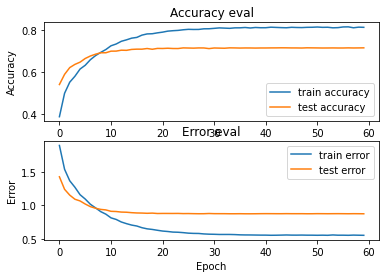

In [43]:
plot_history(cnnModelHistory)

In [11]:
# Storing best model
MODEL_PATH ="./resumeData/00013-test-train/model-60-0.88.hdf5"
OPT_PATH = "./resumeData/00013-test-train/model-60-0.88.pkl"
epoch, model, opt = load_model_data(MODEL_PATH, OPT_PATH)

In [22]:
## Resume training
MODEL_PATH ="./resumeData/00015-test-train/model-47-1.03.hdf5"
OPT_PATH = "./resumeData/00015-test-train/model-47-1.03.pkl"
epoch, model, opt = load_model_data(MODEL_PATH, OPT_PATH)

optimizer = keras.optimizers.Adam.from_config(opt)
model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics = ['accuracy'])

cnnModelHistory = train_model(model = model, initial_epoch = epoch, max_epochs = 70, X_train = X_train, y_train = y_train, X_test = X_test, y_test = y_test, validation_data = (X_validation, y_validation))

Epoch 48/70

Epoch 48: saving model to ./resumeData/00016-test-train\model-48-1.03.hdf5

Epoch 00048: saving optimizer to ./resumeData/00016-test-train\model-48-1.03.pkl
1693/1693 - 38s - loss: 1.0337 - accuracy: 0.6552 - val_loss: 1.0302 - val_accuracy: 0.6550 - lr: 1.3379e-07 - 38s/epoch - 22ms/step
Epoch 49/70

Epoch 49: saving model to ./resumeData/00016-test-train\model-49-1.03.hdf5

Epoch 00049: saving optimizer to ./resumeData/00016-test-train\model-49-1.03.pkl
1693/1693 - 39s - loss: 1.0336 - accuracy: 0.6552 - val_loss: 1.0306 - val_accuracy: 0.6542 - lr: 1.0034e-07 - 39s/epoch - 23ms/step
Epoch 50/70

Epoch 50: saving model to ./resumeData/00016-test-train\model-50-1.03.hdf5

Epoch 00050: saving optimizer to ./resumeData/00016-test-train\model-50-1.03.pkl
1693/1693 - 39s - loss: 1.0361 - accuracy: 0.6557 - val_loss: 1.0307 - val_accuracy: 0.6539 - lr: 1.0034e-07 - 39s/epoch - 23ms/step
Epoch 51/70

Epoch 51: saving model to ./resumeData/00016-test-train\model-51-1.03.hdf5

Ep

KeyboardInterrupt: 

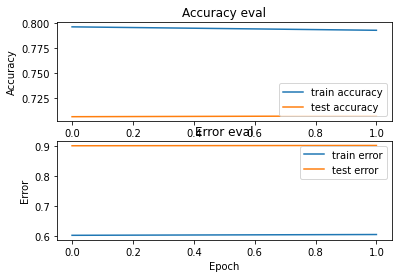

In [46]:
plot_history(cnnModelHistory)

In [12]:
# Make predictions on a sample
X = X_test[100]
y = y_test[100]
predict(model, X, y)

Predicted probabilities :  [[5.3137884e-04 9.8074554e-04 3.6211070e-02 1.8380932e-03 1.6731612e-01
  2.1174587e-07 7.4300641e-01 2.7455776e-03 2.2750070e-02 2.1468037e-05
  1.2148340e-06 5.8142310e-03 1.8363120e-06 8.9835338e-03 9.7979335e-03]]
Expected index : 6, Predicted index : [6]


In [14]:
X.shape

(9, 64, 1)

## Neural network 3 - RNN-LSTM


In [52]:
run_dir = generate_output_dir(outdir = OUTPUT_DIRECTORY, run_desc = RUN_DESC)
print("Results saved to : {}".format(RUN_DESC))
print(run_dir)

Results saved to : test-train
./resumeData/00008-test-train


In [53]:
def prepare_rnn_datasets(test_size, validation_size):
    # Load the data
    X, y = load_data(JSON_PATH)

    # Create train/test split
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = test_size, random_state = 42)

    # Create train/validation split
    X_train, X_validation, y_train, y_validation = train_test_split(X_train, y_train, test_size = validation_size, random_state = 42)

    return X_train, X_validation, X_test, y_train, y_validation, y_test

In [54]:
def build_rnn_model(input_shape):
    # Create model
    model = keras.Sequential()

    # 3 LSTM Layers
    model.add(keras.layers.LSTM(32, input_shape = input_shape, return_sequences = True))

    model.add(keras.layers.LSTM(64, return_sequences = True))

    model.add(keras.layers.LSTM(128, return_sequences = True))

    model.add(keras.layers.LSTM(512))

    # Dense layer
    model.add(keras.layers.Dense(64, activation = 'relu'))
    model.add(keras.layers.Dropout(0.5))

    # Output layer
    model.add(keras.layers.Dense(11, activation = 'softmax'))

    model.summary()

    return model

In [55]:
if __name__ == "__main__":

    # Create train, validation, and test sets
    X_train, X_validation, X_test, y_train, y_validation, y_test = prepare_rnn_datasets(0.2, 0.2)

    input_shape = (X_train.shape[1], X_train.shape[2])

    # Build the CNN network
    model = build_rnn_model(input_shape)

    # Compile the network
    optimizer = keras.optimizers.Adam(learning_rate = 0.0001)
    model.compile(optimizer = optimizer, loss = "sparse_categorical_crossentropy", metrics = ['accuracy'])

    # Train the RNN
    rnnModelHistory = train_model(model = model, initial_epoch = 0, max_epochs = 150, X_train = X_train, y_train = y_train, X_test = X_test, y_test = y_test, validation_data = (X_validation, y_validation))

    # Evaluate the CNN on the test set
    test_error, test_accuracy = model.evaluate(X_test, y_test, verbose = 1)
    print("Accuracy on test set = {}".format(test_accuracy))

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 6, 32)             12416     
                                                                 
 lstm_1 (LSTM)               (None, 6, 64)             24832     
                                                                 
 lstm_2 (LSTM)               (None, 6, 128)            98816     
                                                                 
 lstm_3 (LSTM)               (None, 512)               1312768   
                                                                 
 dense_18 (Dense)            (None, 64)                32832     
                                                                 
 dropout_4 (Dropout)         (None, 64)                0         
                                                                 
 dense_19 (Dense)            (None, 11)               

KeyboardInterrupt: 

In [ ]:
plot_history(rnnModelHistory)
